In [1]:
!pip install catboost
!pip install shap

# Imports

In [2]:
import pickle

import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import uniform, randint

import shap

%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

import warnings
warnings.filterwarnings("ignore")

import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

/root/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


# Load data

In [3]:
filename = 'dataset_KINOPOISK.pkl'
with open('../data/' + filename, 'rb') as f:
    raw_df = pickle.load(f, encoding='utf-8')

# work with copy
df = raw_df.copy(deep=True)

In [5]:
df.head().T

,0,1,2,3,4
age_access_type,12,16,18,18,6
name,Звёздный путь 5: Последний рубеж,Звёздный путь 6: Неоткрытая страна,В поисках древнего артефакта,Прожарка Чарли Шина,Пламенное сердце
director,['cff3362f-ad91-498d-80b3-ea3ab8ec65cf'],['bab6b7f4-4506-458f-9091-d567505674f2'],['895f5774-964a-4c5a-ae22-d697d3e3e620'],['1de22aff-430e-4af9-bf1d-159dbf8e9269'],"['40f78e6d-3c9f-434f-a505-c6ffdd045763', '3321..."
genre,"[Sci-Fi, Action, Thriller, Adventure]","[Sci-Fi, Action, Thriller, Adventure]",[Horror],"[Comedy, Documentary]","[Comedy, Adventure, Family, 287a1485-7a88-4c2f..."
average_rating,6.21,7.2,4.0,6.99,6.4
...,...,...,...,...,...
чета,0,0,0,0,0
зебра,0,0,0,0,0
сидень,0,0,0,0,0
беатрис,0,0,0,0,0


# Preprocessing

In [6]:
from src.preprocessing.preprocessing import SimplePreprocessor

target_name = 'WORLD'
filter_release_year = 2000
list_features = {'ACTOR': 10, 'COMPOSER': 3, 'DESIGN': 2, 'DIRECTOR': 2, 'EDITOR': 2,
                 'OPERATOR': 2, 'PRODUCER': 3, 'WRITER': 2, 'country': 5, 'genre': 10}
skewed_num_features = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA']

preprocessor = SimplePreprocessor(target_name,
                                  list_features,
                                  skewed_num_features,
                                  filter_release_year)

# Model

In [7]:
cat_features = ['age_access_type', 'type']

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)


# Pipeline

In [8]:

from src.pipeline.pipeline import Pipeline

sc_cols = ['duration', 'BUDGET', 'MARKETING', 'RUS', 'USA']
split_filter_year = 2022

pipeline = Pipeline(
                 mode='ml',
                 preprocessor = preprocessor,
                 model = cat_model, 
                 sandart_scaler_cols = sc_cols,
                 splitting_params = {'test_size': 0.1,
                                     'target_name': 'WORLD',
                                     'split_filter_year': split_filter_year},
                 )

In [9]:

%%time
X_train, X_val, X_test, \
y_train, y_val, y_test = pipeline.prepare_data(df)

2023-05-01 14:17:50,853:DEBUG:Starting preprocessing
2023-05-01 14:17:52,708:DEBUG:Splitting dataset on train, val and test


split_filter_year: 2022
CPU times: user 1.8 s, sys: 199 ms, total: 1.99 s
Wall time: 2 s


## Train

In [16]:

train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                        cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                        cat_features=cat_features)

val_dataset = cat.Pool(data=X_val,
                       label=y_val,
                       cat_features=cat_features)

In [22]:
pipeline.train_ml_model(train_dataset, val_dataset)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 2.3725788	total: 22.4ms	remaining: 5m 36s
1:	learn: 2.3238372	total: 30ms	remaining: 3m 44s
2:	learn: 2.2768208	total: 37.5ms	remaining: 3m 7s
3:	learn: 2.2311376	total: 45.4ms	remaining: 2m 50s
4:	learn: 2.1871053	total: 53.4ms	remaining: 2m 40s
5:	learn: 2.1428057	total: 60.9ms	remaining: 2m 32s
6:	learn: 2.1006462	total: 68.3ms	remaining: 2m 26s
7:	learn: 2.0603337	total: 75.9ms	remaining: 2m 22s
8:	learn: 2.0206733	total: 83.6ms	remaining: 2m 19s
9:	learn: 1.9869346	total: 90.8ms	remaining: 2m 16s
10:	learn: 1.9548221	total: 98ms	remaining: 2m 13s
11:	learn: 1.9194870	total: 105ms	remaining: 2m 10s
12:	learn: 1.8865439	total: 112ms	remaining: 2m 9s
13:	learn: 1.8535182	total: 119ms	remaining: 2m 7s
14:	learn: 1.8198164	total: 126ms	remaining: 2m 6s
15:	learn: 1.7910035	total: 134ms	remaining: 2m 5s
16:	learn: 1.7650749	total: 142ms	remaining: 2m 4s
17:	learn: 1.7370948	total: 148ms	remaining: 2m 3s
18:	learn: 1.

{'depth': 8, 'iterations': 10000, 'learning_rate': 0.010406791941429008}

## Predict

In [26]:
y_pred = pipeline.predict(test_dataset)

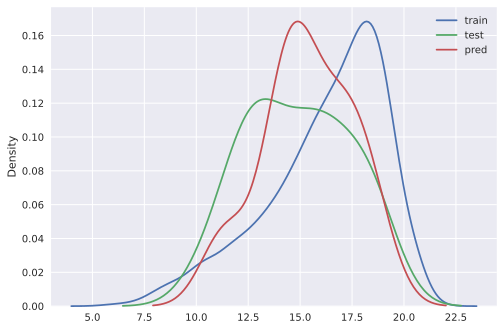

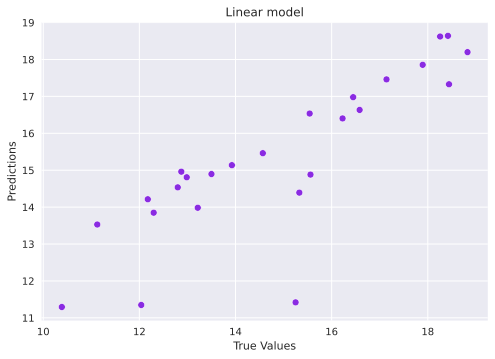

In [27]:
pipeline.draw_curves(y_train, y_test, y_pred)

In [28]:
pipeline.get_scores(y_test, y_pred, transform_mode=True)

MSE:   480021074789059.25
RMSE:  21909383.25898425
R2:    0.7080757371475055
MAE:   10542527.933855293
MedAE: 2631886.575745248
------------------------------


2023-05-01 14:21:27,921:DEBUG:Getting feature importance


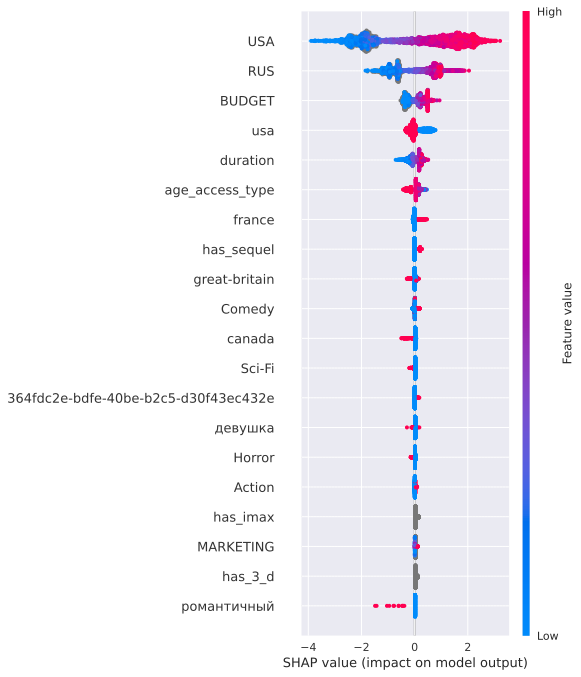

In [21]:
pipeline.get_feature_importance(X_train, y_train, cat_features)

In [35]:
pipeline.save_model(filename='demo_WORLD_cat_boost_model_1')

2023-04-24 12:09:23,255:DEBUG:Saving model


# Run all in

2023-05-01 17:36:39,461:INFO:Running ML regressor pipeline
2023-05-01 17:36:39,494:DEBUG:Starting preprocessing
2023-05-01 17:36:40,886:DEBUG:Splitting dataset on train, val and test


split_filter_year: 2022


2023-05-01 17:36:41,268:INFO:Training model


Learning rate set to 0.060567
0:	learn: 2.2051559	test: 2.8716022	best: 2.8716022 (0)	total: 9.09ms	remaining: 9.08s
100:	learn: 0.7477452	test: 1.2122416	best: 1.2122416 (100)	total: 789ms	remaining: 7.03s
200:	learn: 0.7013617	test: 1.1954702	best: 1.1939040 (176)	total: 1.54s	remaining: 6.12s
300:	learn: 0.6678731	test: 1.1897914	best: 1.1879595 (293)	total: 2.31s	remaining: 5.35s
400:	learn: 0.6415411	test: 1.1871931	best: 1.1868931 (322)	total: 3.06s	remaining: 4.57s
500:	learn: 0.6196237	test: 1.1883342	best: 1.1848875 (435)	total: 3.81s	remaining: 3.79s
600:	learn: 0.5972900	test: 1.1911328	best: 1.1848875 (435)	total: 4.57s	remaining: 3.03s
700:	learn: 0.5782049	test: 1.1924875	best: 1.1848875 (435)	total: 5.32s	remaining: 2.27s
800:	learn: 0.5590685	test: 1.1965418	best: 1.1848875 (435)	total: 6.07s	remaining: 1.51s
900:	learn: 0.5424100	test: 1.1971832	best: 1.1848875 (435)	total: 6.83s	remaining: 751ms


2023-05-01 17:36:48,446:INFO:Starting prediction


Stopped by overfitting detector  (500 iterations wait)

bestTest = 1.184887494
bestIteration = 435

Shrink model to first 436 iterations.


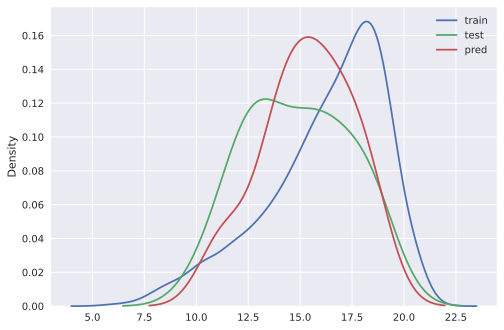

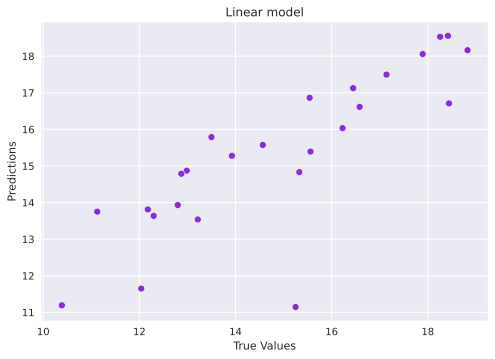

2023-05-01 17:36:48,691:DEBUG:Getting feature importance


MSE:   2.077359076009505
RMSE:  1.441304643720232
R2:    0.6509766212675266
MAE:   1.081144757615045
MedAE: 0.8057598069902099
------------------------------


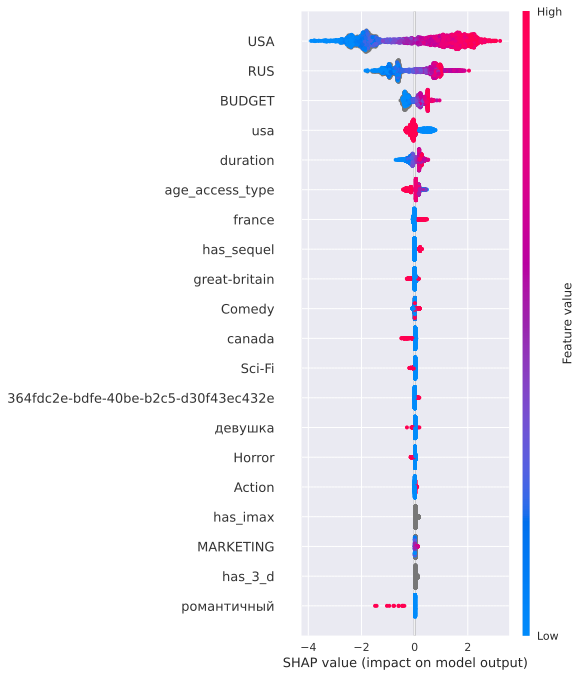

2023-05-01 17:36:50,447:DEBUG:Saving model


In [29]:
pipeline.run_ml_regressor(df, cat_features, model_filename = 'demo_model_world')